<a href="https://colab.research.google.com/github/AswathyRadha100/Aswathy-Repository/blob/main/Retail_project_prophet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install pystan==2.19.1.1
!conda install -c conda-forge prophet


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.2/16.2 MB 82.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pystan: filename=pystan-2.19.1.1-cp310-cp310-linux_x86_64.whl size=61973270 sha256=5eae179737a21f1070e33dc36a95a3b0f517e4cda51f514098db09c87316efd0
  Stored in directory: /root/.cache/pip/wheels/3d/1c/94/4516243362eedbedad15ac4389691ee3bf2d45bec2639c9d8b
Successfully built pystan
/bin/bash: line 1: conda: command not found


In [ ]:
pip install prophet plotly


In [2]:



import pandas as pd
import numpy as np
from prophet import Prophet
import io


In [7]:
from google.colab import files
uploaded = files.upload()

Saving Walmart-Retail-Dataset-new.csv to Walmart-Retail-Dataset-new.csv


In [8]:

df_retail = pd.read_csv(io.BytesIO(uploaded['Walmart-Retail-Dataset-new.csv']))
# Dataset is now stored in a Pandas Dataframe


<ipython-input-8-940828bd5753>:1: DtypeWarning: Columns (22,23,24,25,26,27,28) have mixed types. Specify dtype option on import or set low_memory=False.
  df_retail = pd.read_csv(io.BytesIO(uploaded['Walmart-Retail-Dataset-new.csv']))


In [97]:
df_retail.head()

,city,customer_age,customer_name,customer_segment,discount,order_id,order_priority,order_quantity,product_base_margin,product_category,...,product_sub_category,profit,region,sales,ship_date,ship_mode,shipping_cost,state,unit_price,zip_code
order_date,,,,,,,,,,,,,,,,,,,,,
2020-02-29,Stevens Point,60,Dennis Bolton,Corporate,0.17,a42c8cff-5757-4e94-80b0-807538fefd25,Not Specified,7,0.550000,Furniture,...,Chairs & Chairmats,19559.92268,Central,21.84,2020-03-02,Delivery Truck,3.772509,Wisconsin,3.29,54481
2020-02-29,Stevens Point,60,Dennis Bolton,Corporate,0.17,1c37f301-564f-40ff-bd7d-73a6c06ede1a,Not Specified,7,0.550000,Furniture,...,Chairs & Chairmats,19559.92268,Central,1811.67,2020-03-07,Delivery Truck,816.340894,Wisconsin,258.98,54481
2021-11-11,Grapevine,49,Anthony Garverick,Small Business,0.05,ec649eae-535d-4154-b3ef-c4405bd59da9,Medium,42,0.690000,Furniture,...,Tables,7535.93880,Central,6129.06,2021-11-15,Delivery Truck,4530.505983,Texas,145.98,76051
2020-08-02,Tempe,30,Anne McFarland,Consumer,0.05,efdcbace-5320-4005-95e2-4c94a896dc8c,Not Specified,30,0.370000,Office Supplies,...,Paper,18860.92419,West,198.90,2020-08-08,Regular Air,128.731505,Arizona,6.68,85281
2021-08-13,Coconut Creek,80,Raymond Fair,Home Office,0.14,8fd6c0f6-9e28-45b5-ba21-a57021ae304d,Low,44,0.512816,Office Supplies,...,Storage & Organization,24750.49210,South,1875.28,2021-08-18,Express Air,33.608385,Florida,42.76,33063


In [10]:
df_retail.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999998 entries, 0 to 999997
Data columns (total 29 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   city                  999991 non-null  object
 1   customer_age          999998 non-null  object
 2   customer_name         999985 non-null  object
 3   customer_segment      997500 non-null  object
 4   discount              999998 non-null  object
 5   order_date            999998 non-null  object
 6   order_id              999998 non-null  object
 7   order_priority        997942 non-null  object
 8   order_quantity        999998 non-null  object
 9   product_base_margin   999998 non-null  object
 10  product_category      999998 non-null  object
 11  product_container     995432 non-null  object
 12  product_name          995421 non-null  object
 13  product_sub_category  995432 non-null  object
 14  profit                995432 non-null  object
 15  region           

In [11]:
# Drop columns with high percentages of missing values
df_retail.drop(columns=['Unnamed: 23', 'Unnamed: 24', 'Unnamed: 25', 'Unnamed: 26', 'Unnamed: 27', 'Unnamed: 28'], inplace=True)


In [12]:
# Drop rows with missing 'ship_date' values (4,566 rows) as 'ship_date' contains city and other details
df_retail.dropna(subset=['ship_date'], inplace=True)

In [13]:
# Impute missing values for 'city,' 'customer_name,' and 'customer_segment'
df_retail['city'].fillna(df_retail['city'].mode()[0], inplace=True)
df_retail['customer_name'].fillna(df_retail['customer_name'].mode()[0], inplace=True)
df_retail['customer_segment'].fillna(df_retail['customer_segment'].mode()[0], inplace=True)
df_retail['ship_mode'].fillna(df_retail['ship_mode'].mode()[0], inplace=True)
# Fill 'order_priority' with 'Not Specified'
df_retail['order_priority'].fillna('Not Specified', inplace=True)

# Impute missing 'product_name' with its mode (most common value)
df_retail['product_name'].fillna(df_retail['product_name'].mode()[0], inplace=True)

df_retail['profit'] = pd.to_numeric(df_retail['profit'], errors='coerce').astype(float)

#reassign the order_date column to be a datetime type
df_retail.order_date = pd.to_datetime(df_retail.order_date)

# Convert the 'shipping_cost' column to numeric (float) with error handling
df_retail['shipping_cost'] = pd.to_numeric(df_retail['shipping_cost'], errors='coerce')

# After converting 'shipping_cost' to numeric dtype

# Impute with the mean
df_retail['shipping_cost'].fillna(df_retail['shipping_cost'].mean(), inplace=True)
# Calculate the median of the 'profit' column
median_profit = df_retail['profit'].median()

# Fill missing values in 'profit' with the median
df_retail['profit'].fillna(median_profit, inplace=True)
# Convert 'ship_date' column to datetime with errors='coerce'
df_retail['ship_date'] = pd.to_datetime(df_retail['ship_date'], errors='coerce')

# Filter out rows with invalid dates (NaT)
df_retail = df_retail[~df_retail['ship_date'].isna()]
# Convert 'customer_age' column to int
df_retail['customer_age'] = df_retail['customer_age'].astype(int)

categorical_columns = ['order_priority', 'product_category', 'product_container', 'product_name', 'product_sub_category', 'region', 'state', 'zip_code', 'ship_mode']
df_retail[categorical_columns] = df_retail[categorical_columns].astype('category')

# Convert 'discount' column to float
df_retail['discount'] = pd.to_numeric(df_retail['discount'], errors='coerce')

# Convert 'order_quantity' column to float
df_retail['order_quantity'] = pd.to_numeric(df_retail['order_quantity'], errors='coerce')

# Convert 'product_base_margin' column to float
df_retail['product_base_margin'] = pd.to_numeric(df_retail['product_base_margin'], errors='coerce')

# Convert 'sales' column to float
df_retail['sales'] = pd.to_numeric(df_retail['sales'], errors='coerce')

# Convert 'shipping_cost' column to float
df_retail['shipping_cost'] = pd.to_numeric(df_retail['shipping_cost'], errors='coerce')

# Convert 'unit_price' column to float
df_retail['unit_price'] = pd.to_numeric(df_retail['unit_price'], errors='coerce')

# Impute missing 'sales' values using forward-fill
df_retail['sales'].fillna(method='ffill', inplace=True)

# Impute missing 'unit_price' values using forward-fill (or choose an appropriate method)
df_retail['unit_price'].fillna(method='ffill', inplace=True)

# Impute missing 'product_base_margin' values using mean imputation
mean_margin = df_retail['product_base_margin'].mean()
df_retail['product_base_margin'].fillna(mean_margin, inplace=True)



In [14]:
missing_values = df_retail.isnull()
missing_count = missing_values.sum()
missing_count

city                    0
customer_age            0
customer_name           0
customer_segment        0
discount                0
order_date              0
order_id                0
order_priority          0
order_quantity          0
product_base_margin     0
product_category        0
product_container       0
product_name            0
product_sub_category    0
profit                  0
region                  0
sales                   0
ship_date               0
ship_mode               0
shipping_cost           0
state                   0
unit_price              0
zip_code                0
dtype: int64

In [67]:
df_retail.columns

Index(['city', 'customer_age', 'customer_name', 'customer_segment', 'discount',
       'order_id', 'order_priority', 'order_quantity', 'product_base_margin',
       'product_category', 'product_container', 'product_name',
       'product_sub_category', 'profit', 'region', 'sales', 'ship_date',
       'ship_mode', 'shipping_cost', 'state', 'unit_price', 'zip_code'],
      dtype='object')

In [15]:
# Setting the index
df_retail.set_index('order_date', inplace=True)

In [16]:
# Create the 'data' DataFrame directly from df_retail
data = df_retail.reset_index()

# Rename columns to match Prophet's requirements
data.rename(columns={'order_date': 'ds', 'sales': 'y'}, inplace=True)

# Keep only the 'ds' and 'y' columns
data = data[['ds', 'y']]


In [96]:
data.head()

,ds,y
0,2020-02-29,21.84
1,2020-02-29,1811.67
2,2021-11-11,6129.06
3,2020-08-02,198.90
4,2021-08-13,1875.28


In [138]:
# write the actual data to csv for later use or reporting

data.to_csv('actual_data_forecast_sales.csv', index=False)


In [139]:
from google.colab import files

files.download('actual_data_forecast_sales.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

0      21.84
1    1811.67
2    6129.06
3     198.90
4    1875.28
Name: y, dtype: float64

In [40]:
data.dtype

dtype('float64')

In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 978393 entries, 0 to 978392
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   ds      978393 non-null  datetime64[ns]
 1   y       978393 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 14.9 MB


In [19]:
model = Prophet()
model.fit(data)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/a4y4j5eh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/kefze2ta.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83381', 'data', 'file=/tmp/tmpg0ctd_jd/a4y4j5eh.json', 'init=/tmp/tmpg0ctd_jd/kefze2ta.json', 'output', 'file=/tmp/tmpg0ctd_jd/prophet_modelglgkbhwb/prophet_model-20231003193526.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:35:26 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:36:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [95]:
#
future = model.make_future_dataframe(periods=365)
future.tail()

,ds
1830,2024-01-05
1831,2024-01-06
1832,2024-01-07
1833,2024-01-08
1834,2024-01-09


In [98]:
forecast = model.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
1830,2024-01-05,2223.384328,-8984.664186,13978.194501
1831,2024-01-06,2125.408195,-8829.063987,13708.514401
1832,2024-01-07,2272.441013,-8425.693308,12729.744548
1833,2024-01-08,2224.000269,-9130.537460,13138.538452
1834,2024-01-09,2258.260430,-8505.849788,13234.314449


In [135]:
forecast
# save the forecasted data to a CSV file for later use or reporting
forecast.to_csv('forecast_sales.csv', index=False)


In [136]:
from google.colab import files

files.download('forecast_sales.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

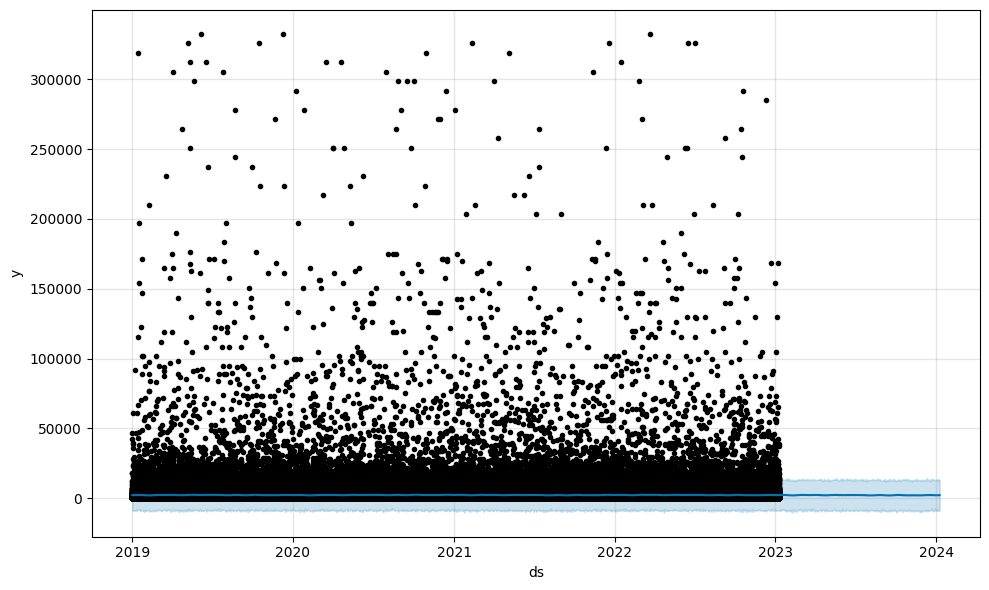

In [99]:
fig1 = model.plot(forecast)


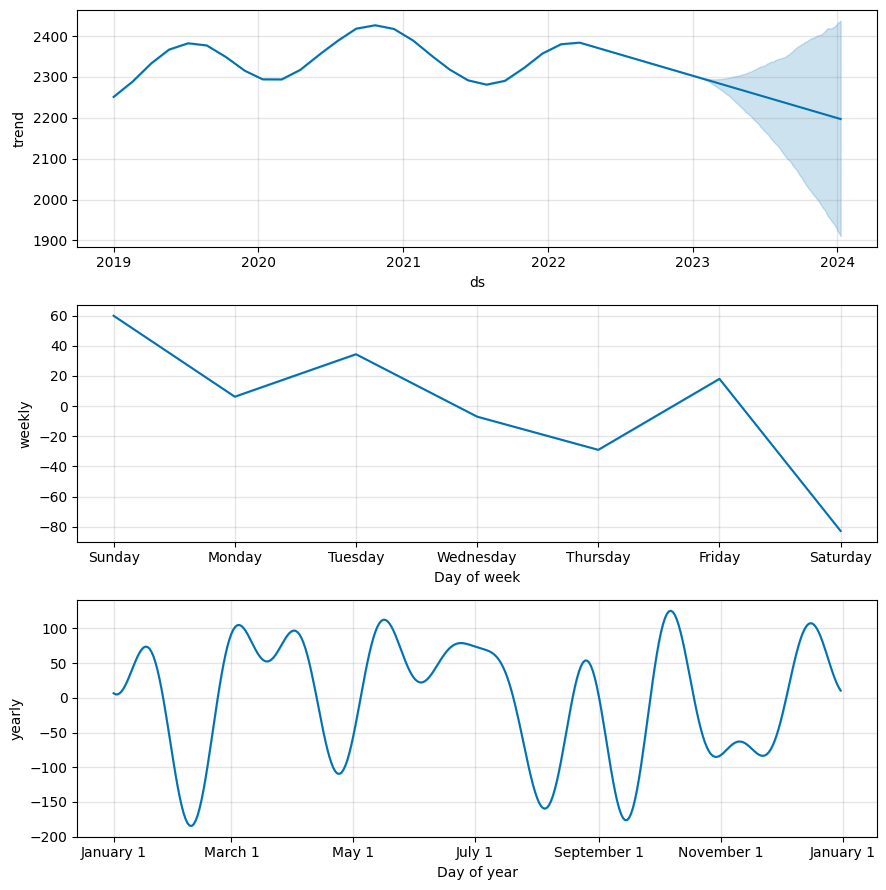

In [100]:
fig2 = model.plot_components(forecast)


In [ ]:
# from prophet.plot import plot_plotly, plot_components_plotly

#plot_plotly(model, forecast)
#model



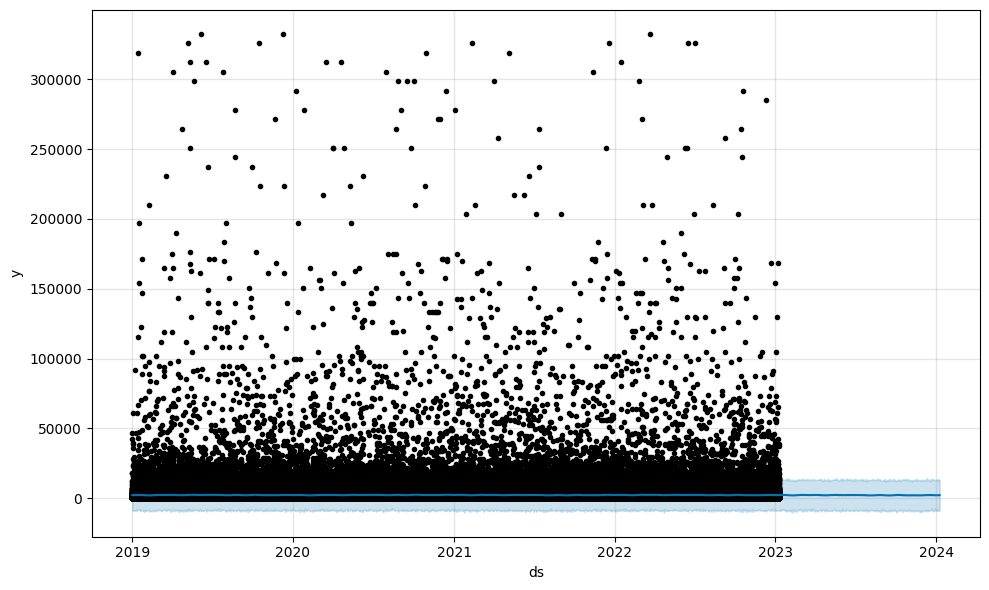

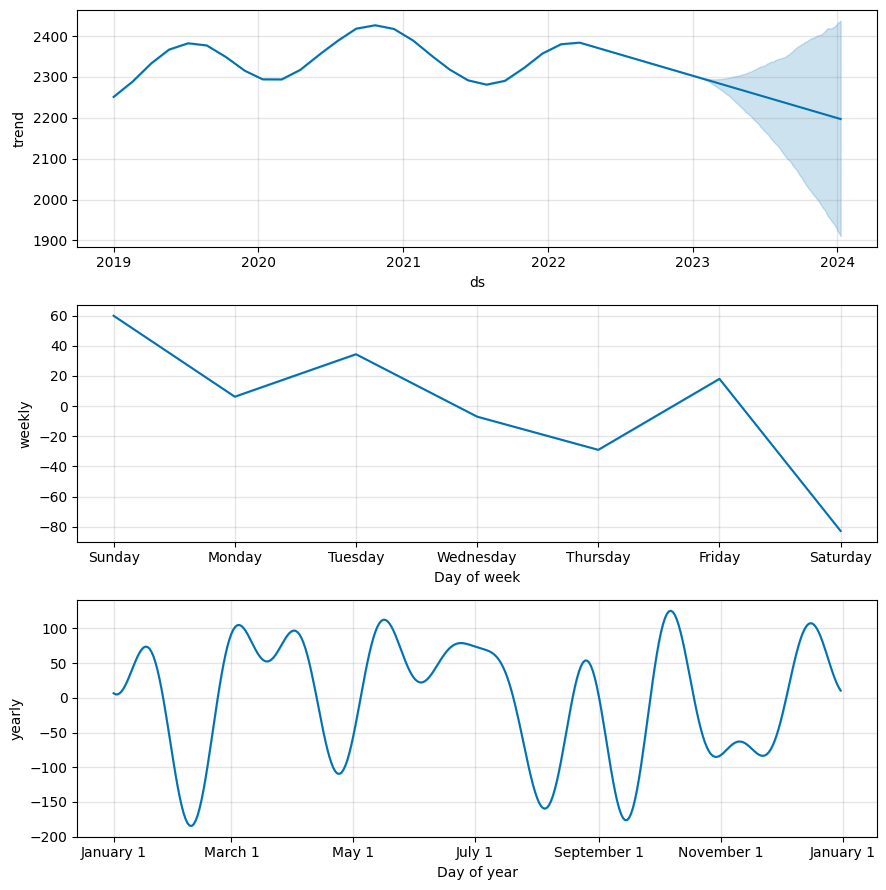

In [101]:
fig1 = model.plot(forecast)
fig2 = model.plot_components(forecast)


In [102]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
1830,2024-01-05,2223.384328,-8984.664186,13978.194501
1831,2024-01-06,2125.408195,-8829.063987,13708.514401
1832,2024-01-07,2272.441013,-8425.693308,12729.744548
1833,2024-01-08,2224.000269,-9130.537460,13138.538452
1834,2024-01-09,2258.260430,-8505.849788,13234.314449


In [94]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
1830,2024-01-05,2511.495569,-8219.973576,13623.725858
1831,2024-01-06,2451.412647,-8055.730078,13435.619546
1832,2024-01-07,2439.285396,-8746.725573,12913.177026
1833,2024-01-08,2445.102268,-7900.869031,13185.414203
1834,2024-01-09,2427.107786,-8582.011004,13157.501646


In [52]:
##redoing the earlier step
# Create the 'data' DataFrame directly from df_retail
data = df_retail.reset_index()

# Rename columns to match Prophet's requirements
data.rename(columns={'order_date': 'ds', 'sales': 'y'}, inplace=True)

# Keep only the 'ds' and 'y' columns
data = data[['ds', 'y']]

In [103]:
data.head()

,ds,y
0,2020-02-29,21.84
1,2020-02-29,1811.67
2,2021-11-11,6129.06
3,2020-08-02,198.90
4,2021-08-13,1875.28


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

actual_values = data['y']
predicted_values = forecast['yhat']

mae = mean_absolute_error(actual_values, predicted_values)
mse = mean_squared_error(actual_values, predicted_values)

print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)


In [59]:
# Assuming you want to keep only the first 1835 values of actual_values
actual_values = actual_values[:1835]

# Now you can calculate the metrics
mae = mean_absolute_error(actual_values, predicted_values)
mse = mean_squared_error(actual_values, predicted_values)


In [60]:
print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)


Mean Absolute Error: 2801.418735455768
Mean Squared Error: 58882806.054378845


In [54]:
model = Prophet(seasonality_mode='multiplicative')
model.fit(data)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/62wdd4rg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/g5vxo4zw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38797', 'data', 'file=/tmp/tmpg0ctd_jd/62wdd4rg.json', 'init=/tmp/tmpg0ctd_jd/g5vxo4zw.json', 'output', 'file=/tmp/tmpg0ctd_jd/prophet_modelq5qi8yk9/prophet_model-20231003204454.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:44:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:46:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [63]:
future_forecast = model.predict(future)


In [64]:
forecast.to_csv('forecast_results.csv', index=False)


In [93]:
from google.colab import files
uploaded = files.upload()

Saving Cleaned_retail_df_cs_d_s.csv to Cleaned_retail_df_cs_d_s (1).csv


In [106]:

df_cust_seg = pd.read_csv(io.BytesIO(uploaded['Cleaned_retail_df_cs_d_s.csv']))
# Dataset is now stored in a Pandas Dataframe

KeyError: ignored

In [92]:
df_cust_seg.head()  # Display the first few rows of the DataFrame


,customer_segment,order_date,sales
0,Corporate,2020-02-29,21.84
1,Corporate,2020-02-29,1811.67
2,Small Business,2021-11-11,6129.06
3,Consumer,2020-08-02,198.90
4,Home Office,2021-08-13,1875.28


In [74]:
df_cust_seg['order_date'] = pd.to_datetime(df_cust_seg['order_date'])


In [91]:
df_cust_seg.head()

,customer_segment,order_date,sales
0,Corporate,2020-02-29,21.84
1,Corporate,2020-02-29,1811.67
2,Small Business,2021-11-11,6129.06
3,Consumer,2020-08-02,198.90
4,Home Office,2021-08-13,1875.28


In [76]:
customer_segments = df_cust_seg.groupby('customer_segment')


In [ ]:
########

In [82]:
segment_forecasts = {}  # Dictionary to store forecasts for each segment

for segment, segment_data in customer_segments:
    # Create and fit a Prophet model for each customer segment
    model = Prophet()
    model.fit(segment_data.rename(columns={'order_date': 'ds', 'sales': 'y'}))

    # Generate forecasts for this segment
    future = model.make_future_dataframe(periods=365)  # Adjust forecasting horizon
    segment_forecast = model.predict(future)

    # Store the forecast results in the dictionary
    segment_forecasts[segment] = segment_forecast


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/pgu9jgb7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/9dt92wg6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96633', 'data', 'file=/tmp/tmpg0ctd_jd/pgu9jgb7.json', 'init=/tmp/tmpg0ctd_jd/9dt92wg6.json', 'output', 'file=/tmp/tmpg0ctd_jd/prophet_model1gddtecd/prophet_model-20231003220021.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
22:00:21 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
22:00:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0

In [ ]:
# After storing the forecast results for each customer segment in the segment_forecasts dictionary,  combine these forecasts into a single DataFrame with a 'customer_segment' column

In [83]:
# Combine forecasts into a single DataFrame with a 'customer_segment' column
combined_forecast = pd.concat([df.assign(customer_segment=segment) for segment, df in segment_forecasts.items()], ignore_index=True)


In [84]:
# Analyze customer segment-specific trends and forecasted sales
segment_trends = combined_forecast.groupby('customer_segment')[['ds', 'yhat']].tail()  # Extract relevant columns


In [85]:
# Export the customer segment-specific forecast results to a CSV file
combined_forecast.to_csv('segmented_forecast_results.csv', index=False)


In [86]:
from google.colab import files

files.download('segmented_forecast_results.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

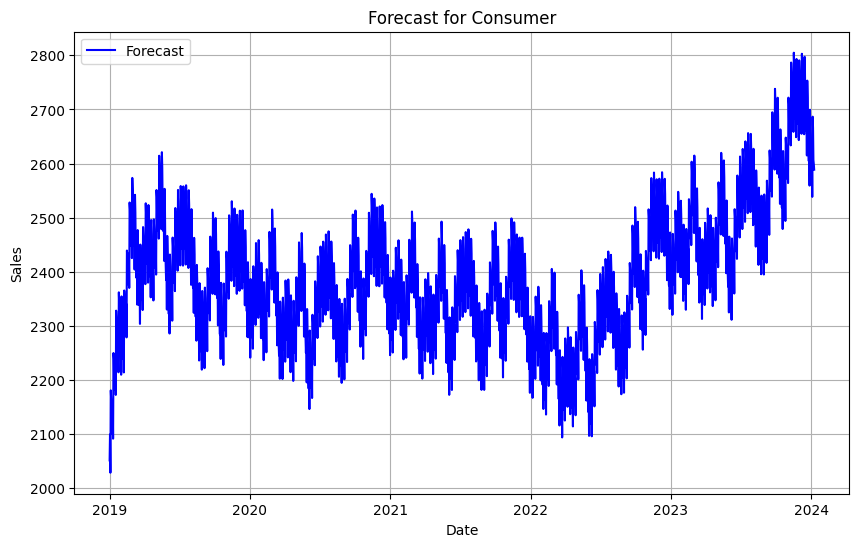

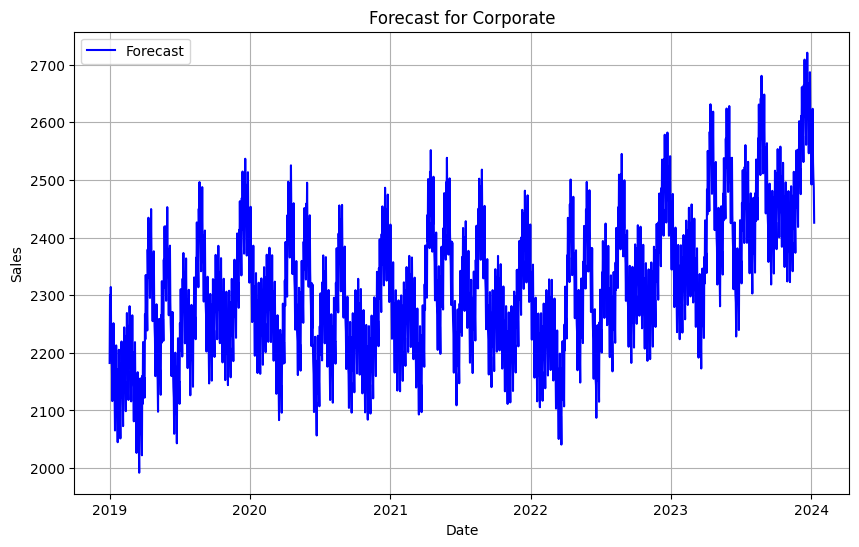

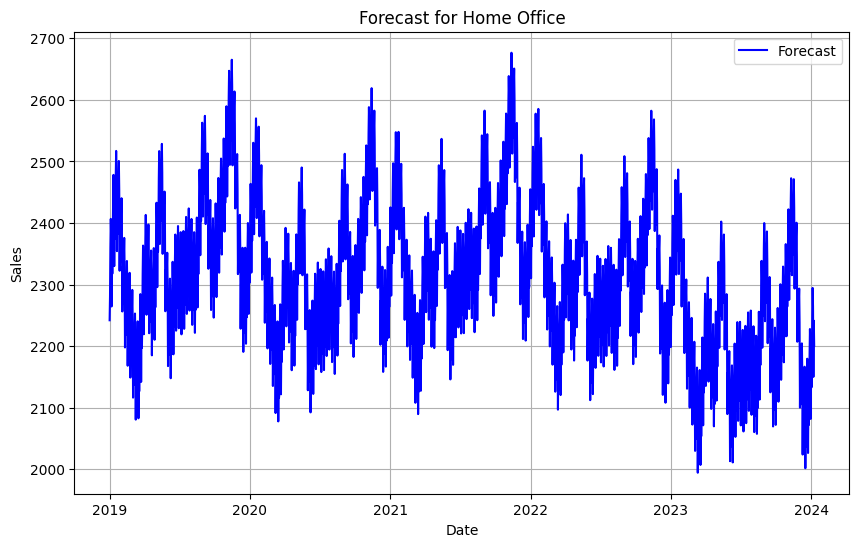

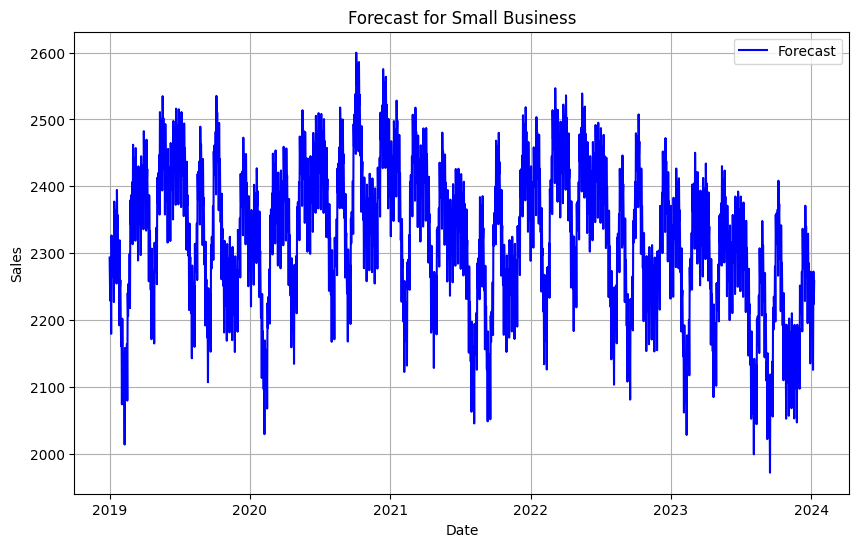

In [90]:
import matplotlib.pyplot as plt

# Create a plot for each customer segment
for segment, segment_forecast in segment_forecasts.items():
    # Extract relevant columns for the segment
    segment_data = combined_forecast[combined_forecast['customer_segment'] == segment]

    # Create a time series plot
    plt.figure(figsize=(10, 6))
    plt.plot(segment_data['ds'], segment_data['yhat'], label='Forecast', color='blue')
    # Add the actual values if available
    if 'y' in segment_data.columns:
        plt.plot(segment_data['ds'], segment_data['y'], label='Actual', color='red')
    plt.title(f'Forecast for {segment}')
    plt.xlabel('Date')
    plt.ylabel('Sales')
    plt.legend()
    plt.grid(True)
    plt.show()


In [104]:
# Loading cleaned dataset for doing Inventory Management ('cleaned_od_oq.csv')
# Load  historical data
from google.colab import files
uploaded = files.upload()

Saving cleaned_od_oq.csv to cleaned_od_oq.csv


In [108]:
df_inventory_seg = pd.read_csv(io.BytesIO(uploaded['cleaned_od_oq.csv']))
# Dataset is now stored in a Pandas Dataframe

In [109]:
df_inventory_seg.head()

,order_date,order_quantity
0,2020-02-29,7
1,2020-02-29,7
2,2021-11-11,42
3,2020-08-02,30
4,2021-08-13,44


In [110]:
# Load historical data from 'df_inventory_seg' (it contains 'order_date' and 'order_quantity')
data = df_inventory_seg.copy()

# Rename columns to match Prophet's requirements
data.rename(columns={'order_date': 'ds', 'order_quantity': 'y'}, inplace=True)

# Keep only the 'ds' and 'y' columns
data = data[['ds', 'y']]


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/dq8w8bhq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpg0ctd_jd/vsltpcq4.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=45955', 'data', 'file=/tmp/tmpg0ctd_jd/dq8w8bhq.json', 'init=/tmp/tmpg0ctd_jd/vsltpcq4.json', 'output', 'file=/tmp/tmpg0ctd_jd/prophet_modelp3bl90jh/prophet_model-20231004022319.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
02:23:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:27:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


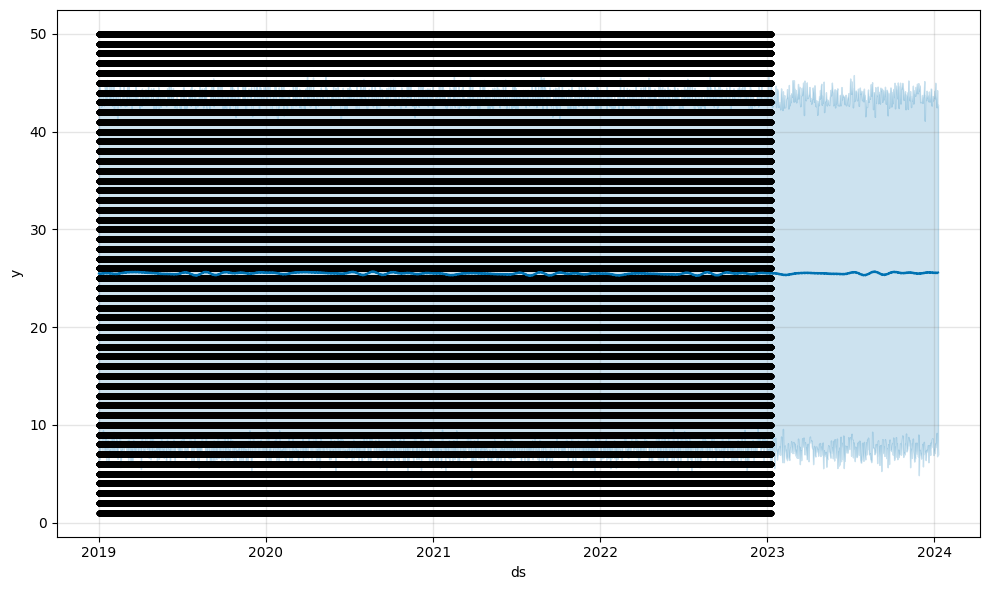

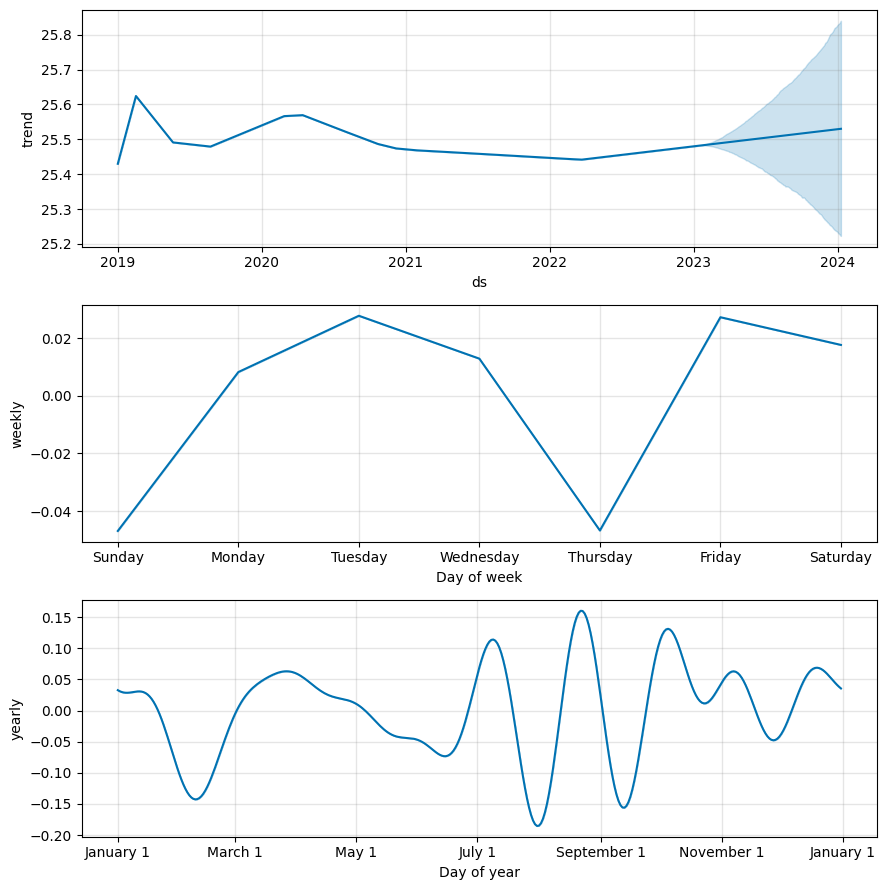

In [111]:
# Now proceed with using Prophet to forecast inventory quantities

# Create a Prophet model
model = Prophet()

# Fit the model to your historical data
model.fit(data)

# Create a future DataFrame for forecasting
future = model.make_future_dataframe(periods=365)  # Adjust the forecasting horizon as needed

# Generate forecasts
forecast = model.predict(future)

# Visualize the forecast
fig1 = model.plot(forecast)

# Visualize the components of the forecast (trend, seasonality, holidays, etc.)
fig2 = model.plot_components(forecast)

In [112]:
forecasted_inventory = forecast[['ds', 'yhat']]


In [113]:
forecasted_lower_bound = forecast[['ds', 'yhat_lower']]
forecasted_upper_bound = forecast[['ds', 'yhat_upper']]


In [114]:
# Filter forecasted values for a specific date range (e.g., next 30 days)
forecasted_next_30_days = forecasted_inventory.tail(30)


In [115]:
# save the forecasted data to a CSV file for later use or reporting
forecasted_inventory.to_csv('forecasted_inventory.csv', index=False)


In [118]:
from google.colab import files

files.download('forecasted_inventory.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [124]:
# save the forecasted data to a CSV file for later use or reporting
forecasted_lower_bound.to_csv('forecasted_lower_bound.csv', index=False)
forecasted_upper_bound.to_csv('forecasted_upper_bound.csv', index=False)


In [125]:
from google.colab import files

files.download('forecasted_lower_bound.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [126]:
from google.colab import files

files.download('forecasted_upper_bound.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [131]:
# Model Validation:

import pandas as pd
from sklearn.metrics import mean_absolute_error

# Load actual values and forecasted bounds, specifying data types if needed
actual_data = pd.read_csv("cleaned_od_oq.csv")
lower_bound = pd.read_csv("forecasted_lower_bound.csv")
upper_bound = pd.read_csv("forecasted_upper_bound.csv")

# Calculate MAE for the forecast
forecasted_values = (lower_bound["yhat_lower"] + upper_bound["yhat_upper"]) / 2
mae = mean_absolute_error(actual_data["order_quantity"], forecasted_values)

print(f"Mean Absolute Error: {mae}")


ValueError: ignored

In [133]:
import pandas as pd

# Load actual data and forecasted values
actual_data = pd.read_csv("cleaned_od_oq.csv")
lower_bound = pd.read_csv("forecasted_lower_bound.csv")
upper_bound = pd.read_csv("forecasted_upper_bound.csv")

# Display the first few rows of each dataset
print("Actual Data:")
print(actual_data.head())

print("\nForecasted Lower Bound:")
print(lower_bound.head())

print("\nForecasted Upper Bound:")
print(upper_bound.head())


Actual Data:
   order_date  order_quantity
0  2020-02-29               7
1  2020-02-29               7
2  2021-11-11              42
3  2020-08-02              30
4  2021-08-13              44

Forecasted Lower Bound:
           ds  yhat_lower
0  2019-01-01    6.296104
1  2019-01-02    7.101073
2  2019-01-03    6.535489
3  2019-01-04    7.385472
4  2019-01-05    8.275525

Forecasted Upper Bound:
           ds  yhat_upper
0  2019-01-01   44.458184
1  2019-01-02   44.631440
2  2019-01-03   44.443026
3  2019-01-04   43.913921
4  2019-01-05   44.192454


In [134]:
# Filter forecasted datasets to include dates in 2020 and 2021
start_date = '2020-01-01'
end_date = '2021-12-31'

filtered_lower_bound = lower_bound[(lower_bound['ds'] >= start_date) & (lower_bound['ds'] <= end_date)]
filtered_upper_bound = upper_bound[(upper_bound['ds'] >= start_date) & (upper_bound['ds'] <= end_date)]

# Verify the updated forecasted datasets
print("Updated Forecasted Lower Bound:")
print(filtered_lower_bound.head())

print("\nUpdated Forecasted Upper Bound:")
print(filtered_upper_bound.head())

# Calculate MAE with the updated forecasted datasets
forecasted_values = (filtered_lower_bound["yhat_lower"] + filtered_upper_bound["yhat_upper"]) / 2
mae = mean_absolute_error(actual_data["order_quantity"], forecasted_values)

print(f"Mean Absolute Error: {mae}")


Updated Forecasted Lower Bound:
             ds  yhat_lower
365  2020-01-01    6.154141
366  2020-01-02    7.168127
367  2020-01-03    6.930742
368  2020-01-04    9.408618
369  2020-01-05    7.840200

Updated Forecasted Upper Bound:
             ds  yhat_upper
365  2020-01-01   44.080418
366  2020-01-02   44.345178
367  2020-01-03   43.373821
368  2020-01-04   44.632982
369  2020-01-05   43.732775


ValueError: ignored

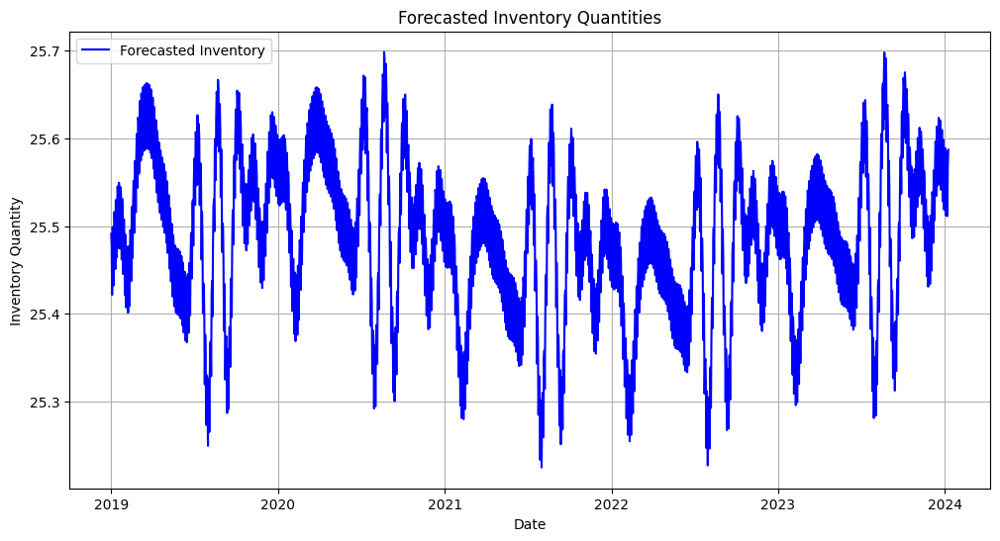

In [119]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the forecasted inventory data
forecasted_inventory = pd.read_csv('forecasted_inventory.csv')


# Convert 'ds' column to datetime
forecasted_inventory['ds'] = pd.to_datetime(forecasted_inventory['ds'])

# Create a line plot to visualize forecasted inventory quantities
plt.figure(figsize=(12, 6))
plt.plot(forecasted_inventory['ds'], forecasted_inventory['yhat'], label='Forecasted Inventory', color='blue')
plt.title('Forecasted Inventory Quantities')
plt.xlabel('Date')
plt.ylabel('Inventory Quantity')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


In [ ]:
# Overall, the inventory predictions for 2023 and 2024 exhibit seasonal variations that align with the historical patterns observed in the years prior (2019-2022).
# These recurring patterns can be useful for inventory management and planning, allowing them to anticipate higher and lower inventory levels during specific periods of the year.

In [ ]:
# Loading cleaned dataset for doing Inventory Management ('cleaned_od_oq.csv')
# Load  historical data
from google.colab import files
uploaded = files.upload()

In [ ]:
df_inventory_seg = pd.read_csv(io.BytesIO(uploaded['cleaned_od_oq.csv']))
# Dataset is now stored in a Pandas Dataframe

In [ ]:
# Load historical data from 'df_inventory_seg' (it contains 'order_date' and 'order_quantity')
data = df_inventory_seg.copy()

# Rename columns to match Prophet's requirements
data.rename(columns={'order_date': 'ds', 'order_quantity': 'y'}, inplace=True)

# Keep only the 'ds' and 'y' columns
data = data[['ds', 'y']]


In [ ]:
# Now proceed with using Prophet to forecast inventory quantities

# Create a Prophet model
model = Prophet()

# Fit the model to your historical data
model.fit(data)

# Create a future DataFrame for forecasting
future = model.make_future_dataframe(periods=365)  # Adjust the forecasting horizon as needed

# Generate forecasts
forecast = model.predict(future)

# Visualize the forecast
fig1 = model.plot(forecast)

# Visualize the components of the forecast (trend, seasonality, holidays, etc.)
fig2 = model.plot_components(forecast)